# "I'm Something of a Painter Myself" Project
* mini-project for a Intro to Deep Learning at CU Boulder
* week 5: GANs



## **Brief Description of the Problem & Data**
(as required by the class)

*Problem:*
* Build a GAN that generates 7 to 10 thousand, 256x256 sized, Monet - style images.
* Submissions must use a Kaggle notebook.

*Data:*
* Dataset includes 4 directories, Monet images as JPEG, regular photos as JPEG, Monet images as TFRecord, and regular photos as TFRecord
* The intention is for the models to train on the Monet images and then transform the photos to a Monet style. DCGAN is also acceptable.

*Data Analysis/Discussion:* 
* will be in markdown cells throughout the code, and potentially in inline comments where logical. 

In [1]:
#import statements
import numpy as np
import pandas as pd
import os, shutil, time, random, glob, math
from PIL import Image
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras import layers
from pathlib import Path

2025-08-28 14:00:23.453006: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1756389623.622801      19 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1756389623.677032      19 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


## EDA
* verify files are accessible
* verify number of paintings and photos
* visually inspect a small sample
* compare color intensity

In [2]:
#helper functions

#function to count the number of image files in a folder
def count_images(folder_location):
    file_exts = ('.jpg',)
    #retrieve list of files in the folder
    all_files_in_folder = os.listdir(folder_location)
    #count the files that have the extensions delineated above
    num_files = sum(1 for file in all_files_in_folder if file.lower().endswith(file_exts))
    return num_files


#function to display a grid of 9 images
def show_grid(paths, n=9, seed=42):
    rnd = random.Random(seed)
    sel = rnd.sample(paths, min(n, len(paths)))
    cols = int(math.sqrt(len(sel))); rows = math.ceil(len(sel)/cols)
    plt.figure(figsize=(cols*2.2, rows*2.2))
    for i,p in enumerate(sel,1):
        plt.subplot(rows, cols, i)
        plt.imshow(Image.open(p))
        plt.axis('off')
    plt.tight_layout(); plt.show()


In [3]:
#check directory
is_kaggle = os.path.exists('/kaggle')
working_dir  = '/kaggle/working' if is_kaggle else '/content'
data_dir  = '/kaggle/input/gan-getting-started' if is_kaggle else 'data'
monet_dir = os.path.join(data_dir, 'monet_jpg')
photo_dir = os.path.join(data_dir, 'photo_jpg')

print('is_kaggle: ', is_kaggle)
print('working directory: ', working_dir)
print('data directory: ', data_dir)
print('Monet jpg directory: ', monet_dir)
print('photo jpg directory: ', photo_dir)

is_kaggle:  True
working directory:  /kaggle/working
data directory:  /kaggle/input/gan-getting-started
Monet jpg directory:  /kaggle/input/gan-getting-started/monet_jpg
photo jpg directory:  /kaggle/input/gan-getting-started/photo_jpg


In [4]:
#basic check of files
print(os.listdir(data_dir))
print()

#count number of photos and number of paintings
num_photos = count_images(photo_dir)
num_paintings = count_images(monet_dir)
print(f'number of photos found: {num_photos}')
print(f'number of paintings found: {num_paintings}')

['monet_jpg', 'photo_tfrec', 'photo_jpg', 'monet_tfrec']

number of photos found: 7038
number of paintings found: 300


Sample of Monet files


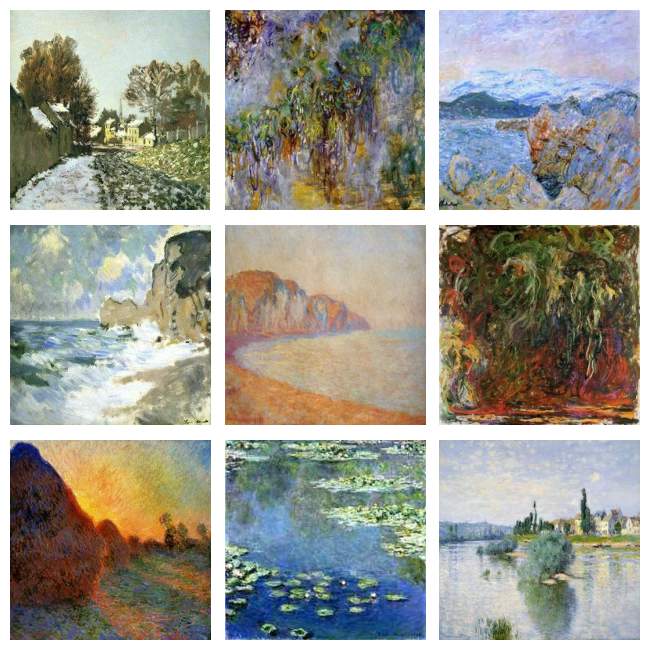

In [5]:
#sample the Monet paintings
monet_files = sorted(glob.glob(os.path.join(monet_dir, '*.jpg')))
print("Sample of Monet files")
show_grid(monet_files, n=9)

Sample of photo files


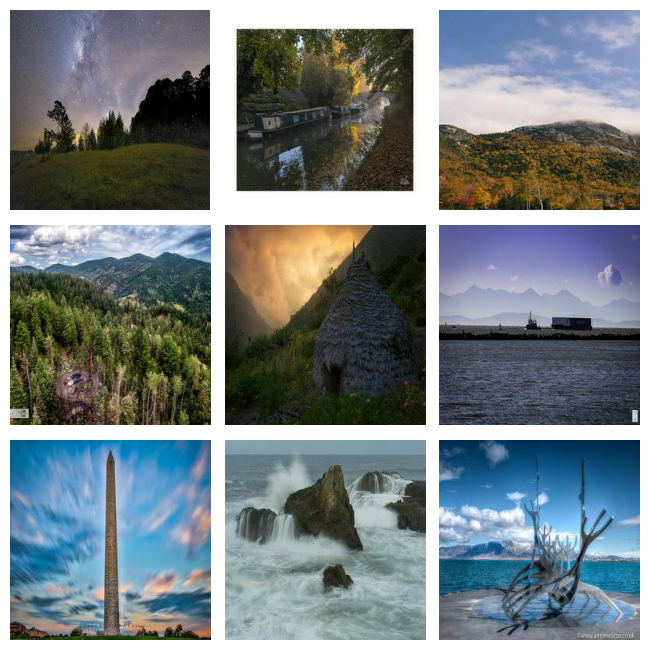

In [6]:
#sample the photos
photo_files = sorted(glob.glob(os.path.join(photo_dir, '*.jpg')))
print("Sample of photo files")
show_grid(photo_files, n=9)

## Building the Model
* I'll start by creating a few helper functions to parse through the TFRecord files
* Then will create the generator and discriminator, for DCGAN implementation

In [7]:
#helper functions for TFRecords
def _parse_function(proto):
    features = {
        'image': tf.io.FixedLenFeature([], tf.string),
    }
    parsed_features = tf.io.parse_single_example(proto, features)
    image = tf.io.decode_jpeg(parsed_features['image'], channels=3)
    image = tf.cast(image, tf.float32)
    image = (image - 127.5) / 127.5
    image = tf.reshape(image, [256, 256, 3])
    return image

# Load the dataset from TFRecords
def load_dataset(tfrecord_files, batch_size):
    dataset = tf.data.TFRecordDataset(tfrecord_files)
    dataset = dataset.map(_parse_function, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.shuffle(buffer_size=10000)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(buffer_size=tf.data.AUTOTUNE)
    return dataset

Generator

In [8]:
def make_gen():
    model = tf.keras.Sequential([
        layers.Dense(8*8*1024, use_bias = False, input_shape = (100,)),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Reshape((8, 8, 1024)),
        layers.Conv2DTranspose(512, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Conv2DTranspose(256, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.Dense(32, activation="relu"),
        layers.BatchNormalization(),
        layers.Dense(10, activation="softmax"),
        layers.BatchNormalization(),
        layers.LeakyReLU(), 
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh')
    ])
    return model

Discriminator

In [9]:
def make_discrim():
    model = tf.keras.Sequential([
        layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[256, 256, 3]),
        layers.LeakyReLU(),
        layers.Dropout(0.3),
        layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'),
        layers.LeakyReLU(),
        layers.Dropout(0.3),
        layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'),
        layers.LeakyReLU(),
        layers.Dropout(0.3),
        layers.Conv2D(512, (5, 5), strides=(2, 2), padding='same'),
        layers.LeakyReLU(),
        layers.Dropout(0.2),
        layers.LeakyReLU(),
        layers.Dropout(0.3),
        layers.LeakyReLU(),
        layers.Dropout(0.2),
        layers.LeakyReLU(),
        layers.Dropout(0.3),
        layers.Flatten(),
        layers.Dense(1)
    ])
    return model

define loss functions and prepare to train the model

In [10]:
#cross entropy
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

#generator loss
def gen_loss(gen_output):
    return cross_entropy(tf.ones_like(gen_output), gen_output)

#discriminator loss
def discrim_loss(disc_out, gen_out):
    actual_loss = cross_entropy(tf.ones_like(disc_out),disc_out)
    false_loss = cross_entropy(tf.zeros_like(gen_out), gen_out)
    total_loss = actual_loss + false_loss
    return total_loss

#training step
@tf.function
def train_step(images, generator, discriminator, generator_optimizer, discriminator_optimizer):
    noise = tf.random.normal([tf.shape(images)[0], 100])  #using dynamic sizing for batch size

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gener_loss = gen_loss(fake_output)
        disc_loss = discrim_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gener_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    return gener_loss, disc_loss

#function to generate and save images
def generate_and_save_images(model, epoch, test_input):
    predictions = model(test_input, training=False)
    fig = plt.figure(figsize=(8, 8))

    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i + 1)
        img = (predictions[i, :, :, :] * 127.5 + 127.5).numpy().astype('uint8')
        plt.imshow(img)
        plt.axis('off')

    plt.show()

#function to do the training
def train(dataset, epochs, generator, discriminator, generator_optimizer, discriminator_optimizer):
    for epoch in range(epochs):
        start = time.time()
        
        gen_loss_list = []
        disc_loss_list = []

        for image_batch in dataset:
            gen_loss, disc_loss = train_step(image_batch, generator, discriminator, generator_optimizer, discriminator_optimizer)
            gen_loss_list.append(gen_loss)
            disc_loss_list.append(disc_loss)

        gen_loss_avg = tf.reduce_mean(gen_loss_list)
        disc_loss_avg = tf.reduce_mean(disc_loss_list)

        if (epoch + 1) == 1 or (epoch + 1) % 20 == 0:
            print(f'Epoch {epoch+1}, generator loss={gen_loss_avg:.4f}, discriminator loss={disc_loss_avg:.4f}, time={time.time()-start:.2f} sec')
            generate_and_save_images(generator, epoch + 1, seed)

set final parameters, build generator & discriminator models, and train them

I0000 00:00:1756389637.916012      19 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
E0000 00:00:1756389648.548699      19 meta_optimizer.cc:966] layout failed: INVALID_ARGUMEN

Epoch 1, generator loss=1.0115, discriminator loss=1.0726, time=25.40 sec


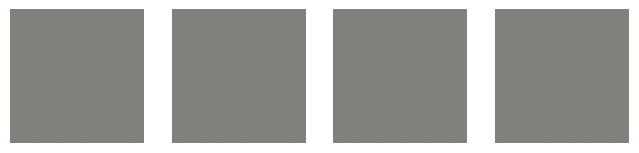

Epoch 20, generator loss=4.6977, discriminator loss=0.0340, time=3.88 sec


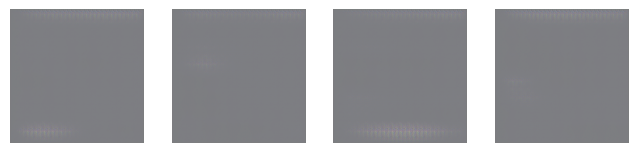

Epoch 40, generator loss=2.9546, discriminator loss=0.5082, time=3.88 sec


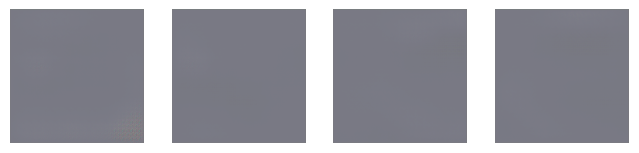

Epoch 60, generator loss=3.6630, discriminator loss=0.2440, time=3.91 sec


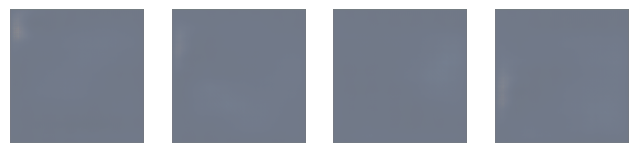

Epoch 80, generator loss=1.3413, discriminator loss=0.7279, time=3.89 sec


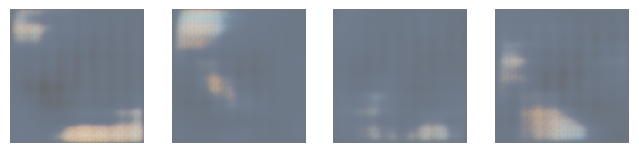

Epoch 100, generator loss=1.6617, discriminator loss=0.6567, time=3.90 sec


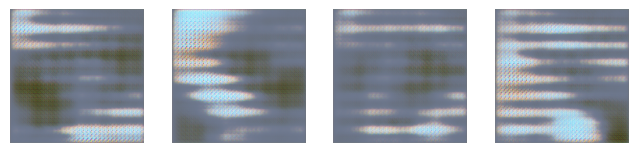

Epoch 120, generator loss=5.6541, discriminator loss=1.3560, time=3.91 sec


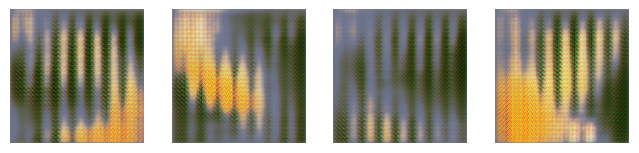

Epoch 140, generator loss=3.4888, discriminator loss=1.2915, time=3.91 sec


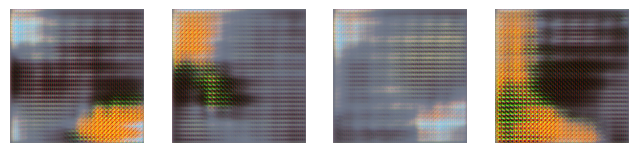

Epoch 160, generator loss=1.6343, discriminator loss=0.6015, time=3.91 sec


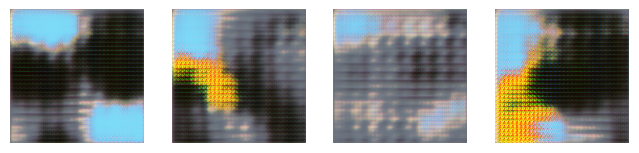

Epoch 180, generator loss=2.8413, discriminator loss=0.4171, time=3.91 sec


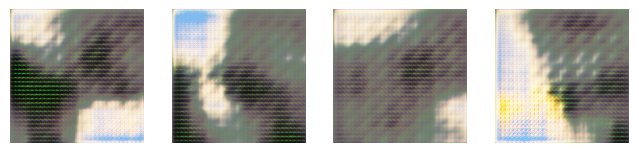

Epoch 200, generator loss=2.8235, discriminator loss=0.4624, time=3.93 sec


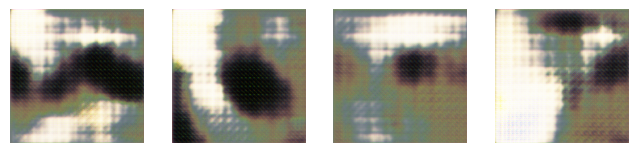

Epoch 220, generator loss=3.1832, discriminator loss=1.5532, time=3.91 sec


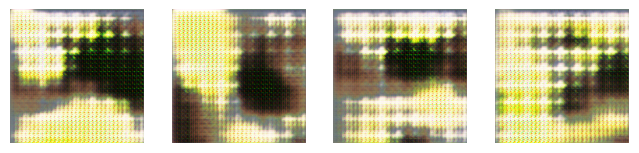

Epoch 240, generator loss=2.5061, discriminator loss=0.4964, time=3.90 sec


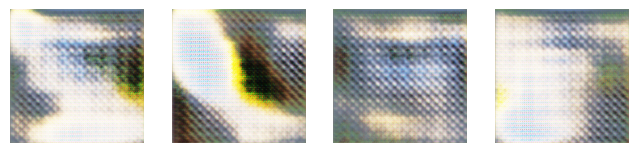

Epoch 260, generator loss=2.4354, discriminator loss=0.3960, time=3.90 sec


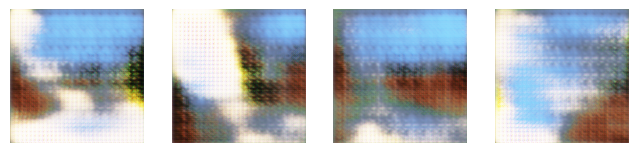

Epoch 280, generator loss=3.3715, discriminator loss=0.2460, time=3.91 sec


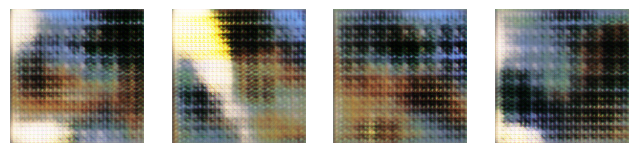

Epoch 300, generator loss=2.5428, discriminator loss=0.3532, time=3.92 sec


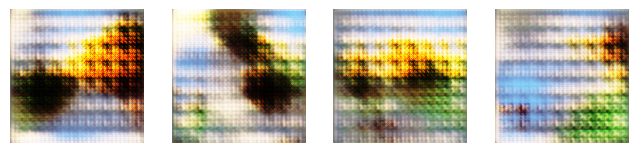

Epoch 320, generator loss=2.9221, discriminator loss=0.4594, time=3.93 sec


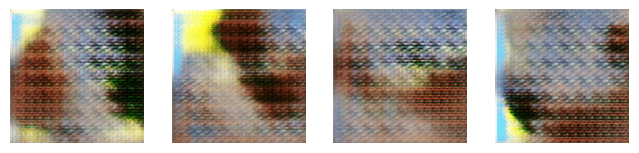

Epoch 340, generator loss=2.8294, discriminator loss=1.1875, time=3.91 sec


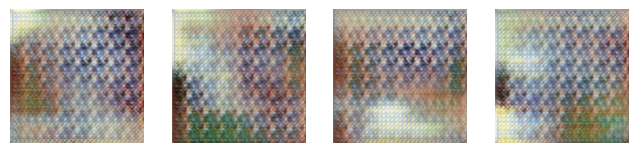

Epoch 360, generator loss=2.3683, discriminator loss=0.4594, time=3.88 sec


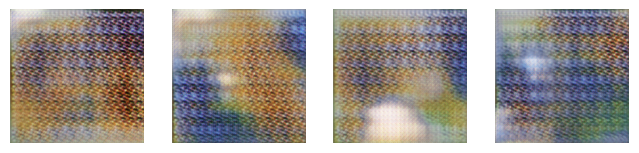

Epoch 380, generator loss=2.5257, discriminator loss=0.4497, time=3.90 sec


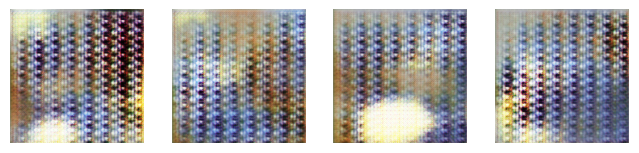

Epoch 400, generator loss=4.2615, discriminator loss=1.0191, time=3.92 sec


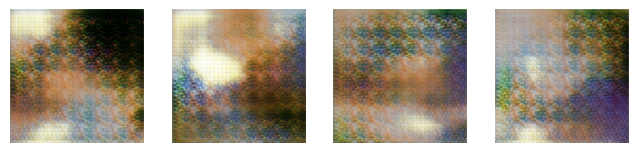

Epoch 420, generator loss=5.0151, discriminator loss=1.1366, time=3.89 sec


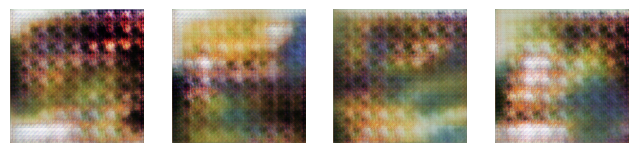

Epoch 440, generator loss=2.5430, discriminator loss=0.3119, time=3.91 sec


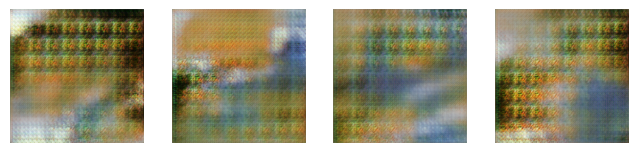

Epoch 460, generator loss=2.2798, discriminator loss=0.3086, time=3.93 sec


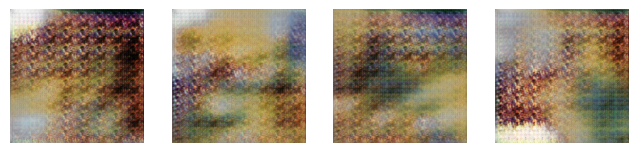

Epoch 480, generator loss=3.1395, discriminator loss=0.5172, time=3.92 sec


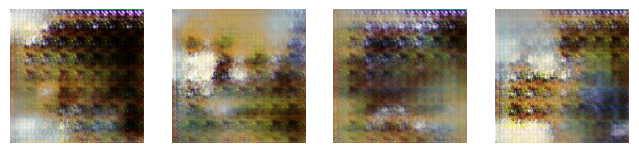

Epoch 500, generator loss=2.9039, discriminator loss=0.3147, time=3.91 sec


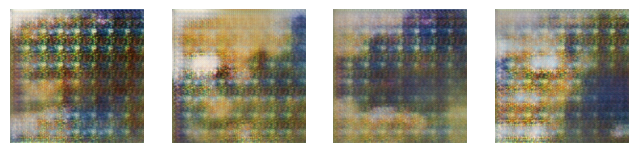

Epoch 520, generator loss=2.2799, discriminator loss=0.4449, time=3.92 sec


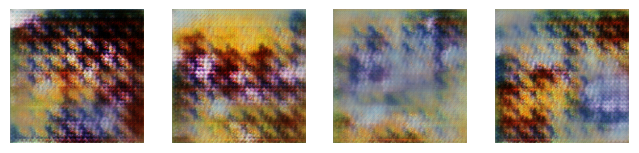

Epoch 540, generator loss=2.3188, discriminator loss=0.4383, time=3.93 sec


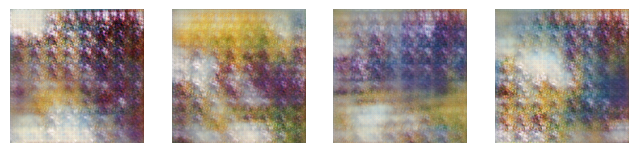

Epoch 560, generator loss=2.5482, discriminator loss=0.3512, time=3.89 sec


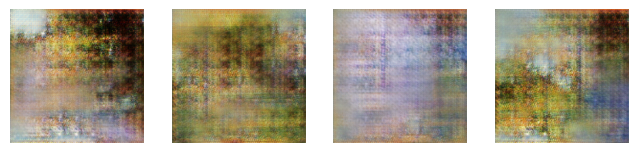

Epoch 580, generator loss=2.3375, discriminator loss=0.4161, time=3.92 sec


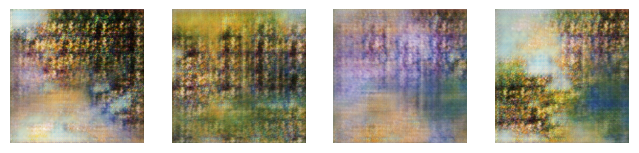

Epoch 600, generator loss=2.1154, discriminator loss=0.4097, time=3.92 sec


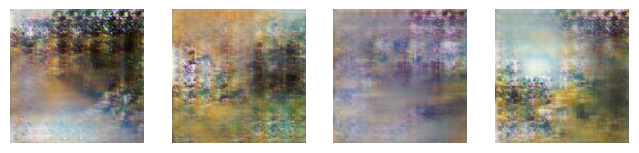

Epoch 620, generator loss=6.0424, discriminator loss=2.3629, time=3.90 sec


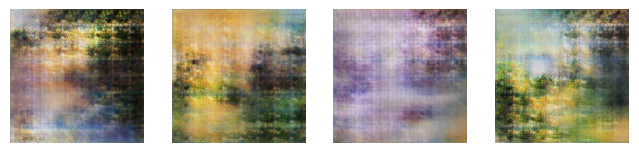

Epoch 640, generator loss=2.4592, discriminator loss=0.4159, time=3.91 sec


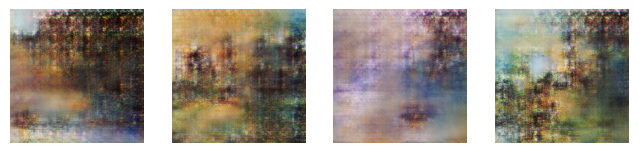

Epoch 660, generator loss=2.3719, discriminator loss=0.4204, time=3.90 sec


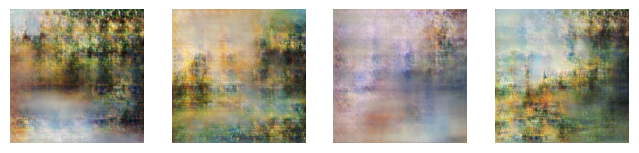

Epoch 680, generator loss=3.3093, discriminator loss=0.6328, time=3.93 sec


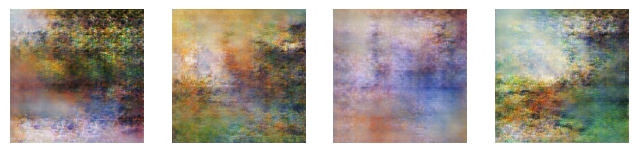

Epoch 700, generator loss=2.3439, discriminator loss=0.3698, time=3.92 sec


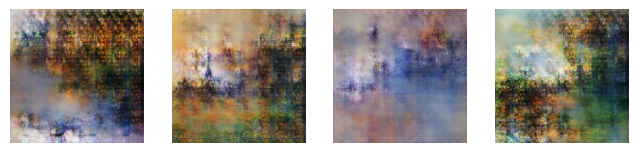

Epoch 720, generator loss=2.5369, discriminator loss=0.3336, time=3.89 sec


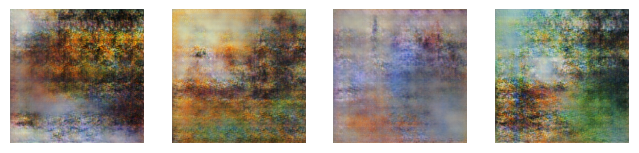

Epoch 740, generator loss=3.1200, discriminator loss=0.2677, time=3.90 sec


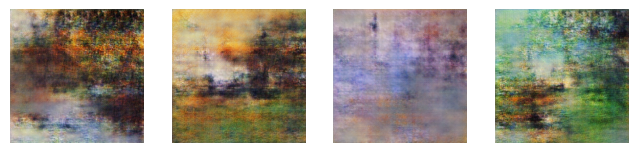

Epoch 760, generator loss=2.5807, discriminator loss=0.3585, time=3.90 sec


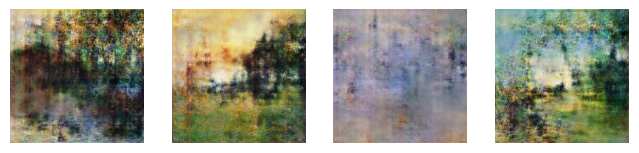

Epoch 780, generator loss=2.7547, discriminator loss=0.2584, time=3.89 sec


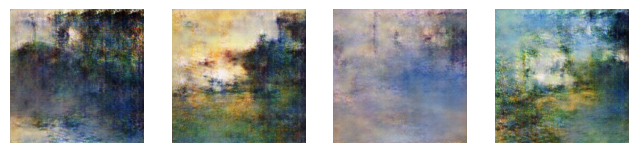

Epoch 800, generator loss=2.4181, discriminator loss=0.3692, time=3.90 sec


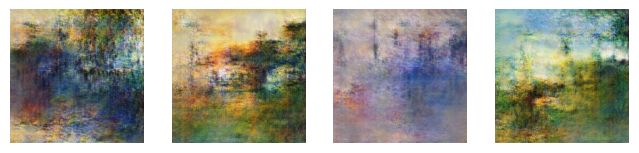

Epoch 820, generator loss=2.7437, discriminator loss=0.3315, time=3.89 sec


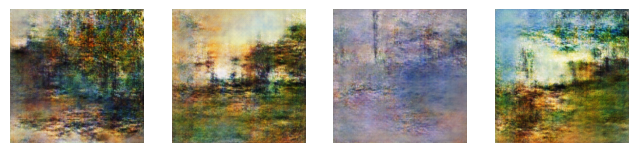

Epoch 840, generator loss=2.8415, discriminator loss=0.3471, time=3.89 sec


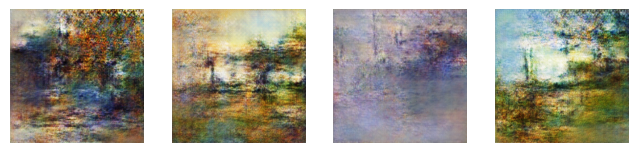

Epoch 860, generator loss=2.9179, discriminator loss=0.2755, time=3.92 sec


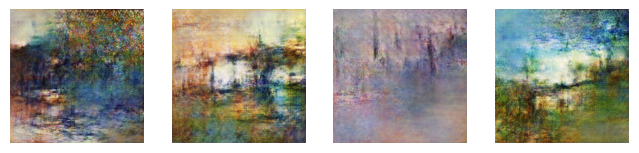

Epoch 880, generator loss=3.3275, discriminator loss=0.2499, time=3.89 sec


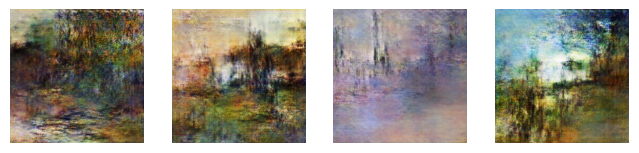

Epoch 900, generator loss=3.2364, discriminator loss=0.2383, time=3.95 sec


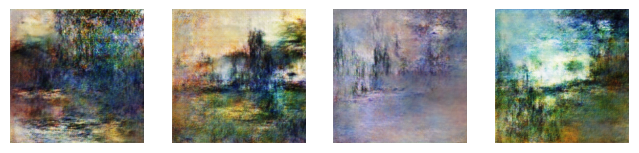

Epoch 920, generator loss=3.6552, discriminator loss=0.1881, time=3.92 sec


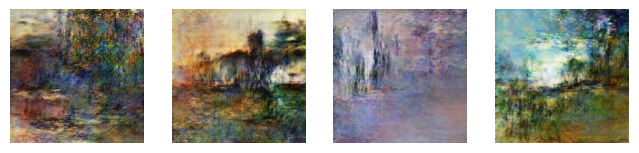

Epoch 940, generator loss=3.7264, discriminator loss=0.2016, time=3.92 sec


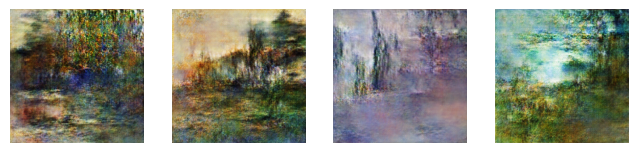

Epoch 960, generator loss=3.7512, discriminator loss=0.1752, time=3.89 sec


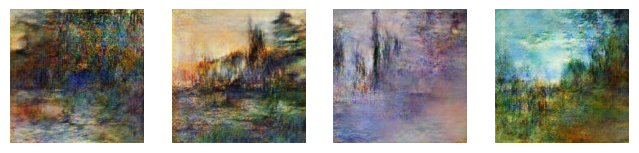

Epoch 980, generator loss=3.9313, discriminator loss=0.1900, time=3.90 sec


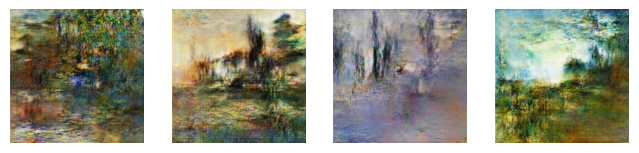

Epoch 1000, generator loss=3.6185, discriminator loss=0.1827, time=3.91 sec


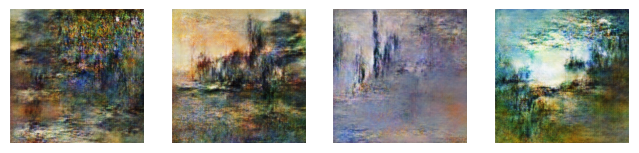

Epoch 1020, generator loss=3.9314, discriminator loss=0.1453, time=3.92 sec


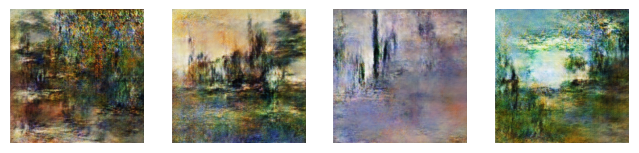

Epoch 1040, generator loss=4.6051, discriminator loss=0.2148, time=3.92 sec


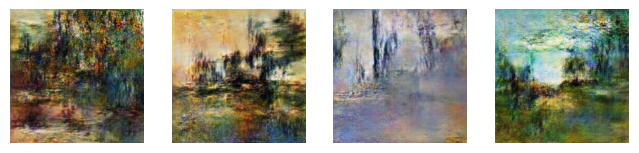

Epoch 1060, generator loss=3.5507, discriminator loss=0.1750, time=3.89 sec


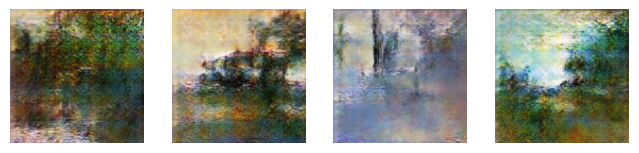

Epoch 1080, generator loss=3.9535, discriminator loss=0.2584, time=3.94 sec


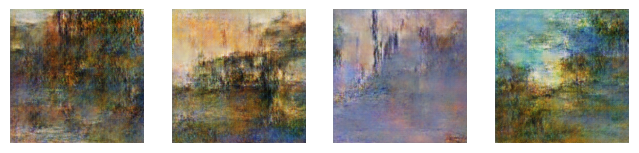

Epoch 1100, generator loss=3.9715, discriminator loss=0.2321, time=3.92 sec


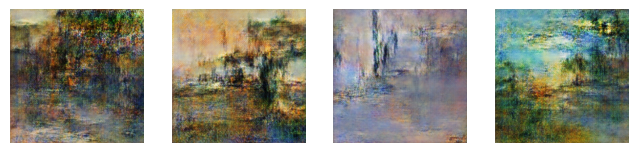

Epoch 1120, generator loss=4.3939, discriminator loss=0.1622, time=3.90 sec


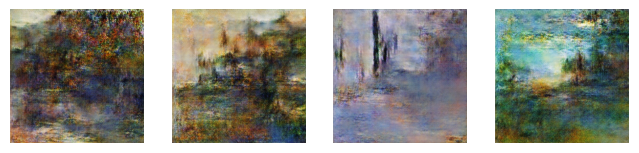

Epoch 1140, generator loss=4.5142, discriminator loss=0.1914, time=3.89 sec


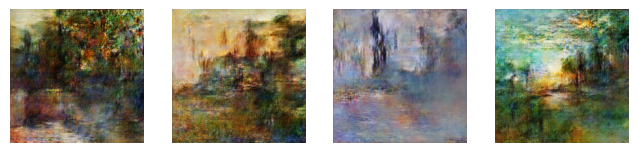

Epoch 1160, generator loss=4.8981, discriminator loss=0.1234, time=3.90 sec


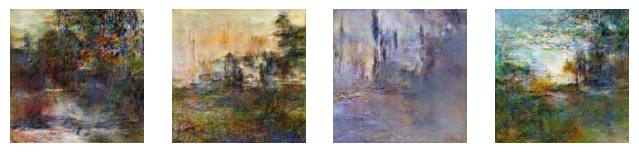

Epoch 1180, generator loss=5.1010, discriminator loss=0.1808, time=3.92 sec


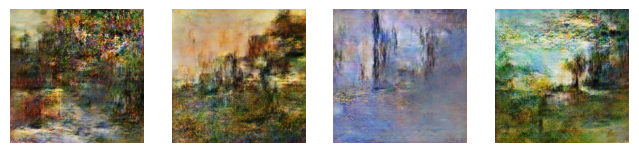

Epoch 1200, generator loss=5.1385, discriminator loss=0.0981, time=3.92 sec


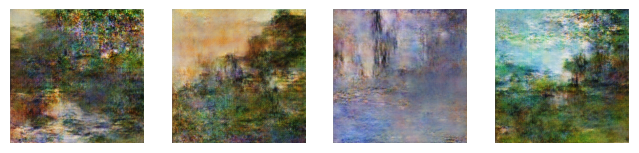

Epoch 1220, generator loss=5.1686, discriminator loss=0.1304, time=3.91 sec


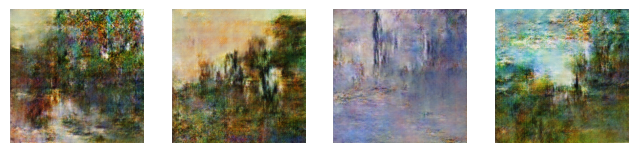

Epoch 1240, generator loss=5.5478, discriminator loss=0.1313, time=3.91 sec


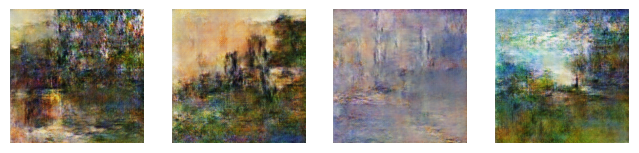

Epoch 1260, generator loss=5.2992, discriminator loss=0.1232, time=3.90 sec


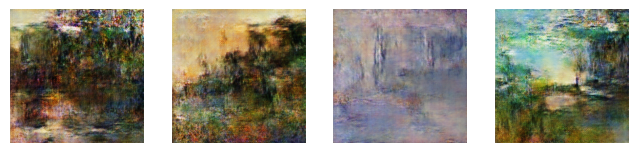

Epoch 1280, generator loss=5.7643, discriminator loss=0.0847, time=3.93 sec


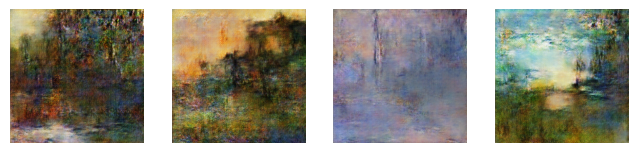

Epoch 1300, generator loss=5.4858, discriminator loss=0.0682, time=3.89 sec


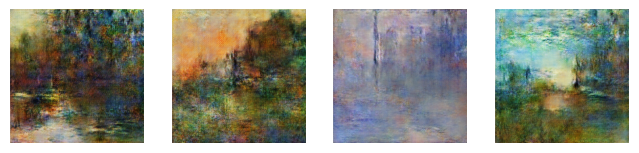

Epoch 1320, generator loss=5.9103, discriminator loss=0.0931, time=3.91 sec


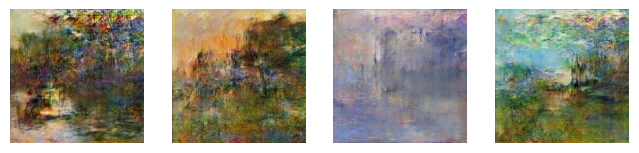

Epoch 1340, generator loss=6.0260, discriminator loss=0.0823, time=3.90 sec


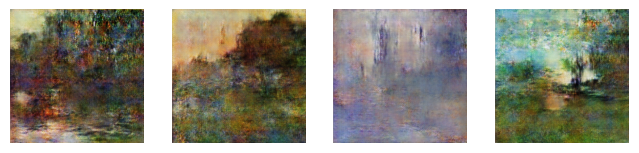

Epoch 1360, generator loss=6.3898, discriminator loss=0.1091, time=3.91 sec


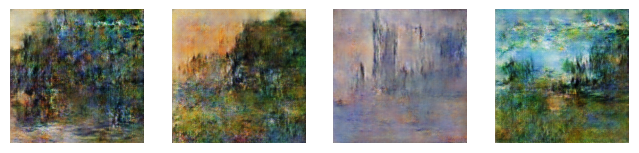

Epoch 1380, generator loss=5.7219, discriminator loss=0.1180, time=3.92 sec


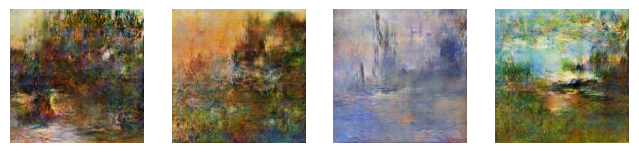

Epoch 1400, generator loss=6.5542, discriminator loss=0.1410, time=3.90 sec


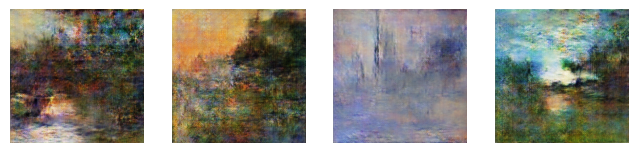

Epoch 1420, generator loss=5.9381, discriminator loss=0.0902, time=3.91 sec


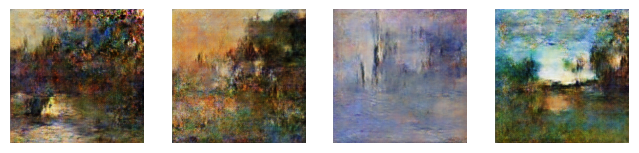

Epoch 1440, generator loss=5.6833, discriminator loss=0.1503, time=3.91 sec


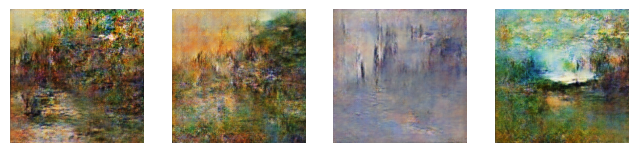

Epoch 1460, generator loss=6.1693, discriminator loss=0.0871, time=3.94 sec


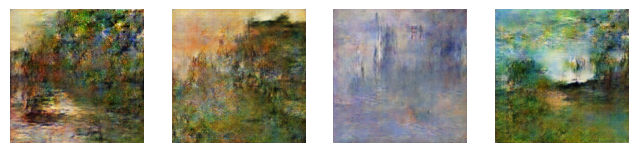

Epoch 1480, generator loss=6.0156, discriminator loss=0.1538, time=3.88 sec


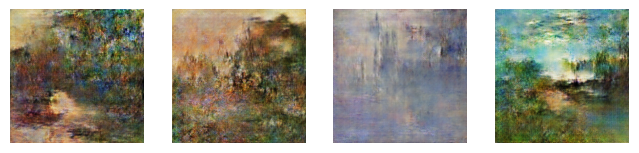

Epoch 1500, generator loss=6.8093, discriminator loss=0.0663, time=3.90 sec


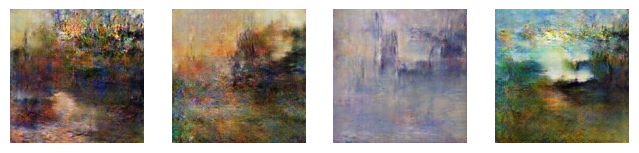

Epoch 1520, generator loss=6.3936, discriminator loss=0.0481, time=3.91 sec


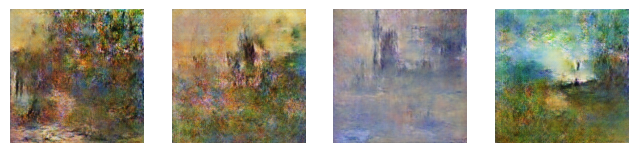

Epoch 1540, generator loss=6.0519, discriminator loss=0.1306, time=3.92 sec


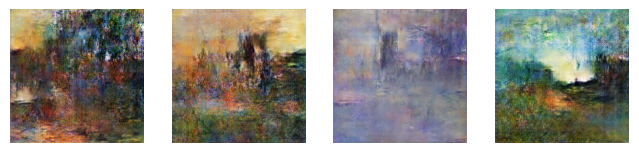

Epoch 1560, generator loss=6.2127, discriminator loss=0.0862, time=3.88 sec


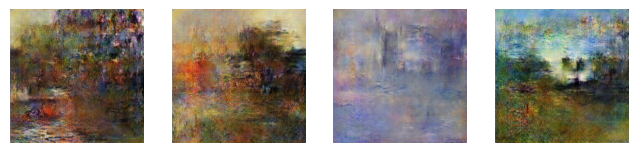

Epoch 1580, generator loss=6.7490, discriminator loss=0.0874, time=3.91 sec


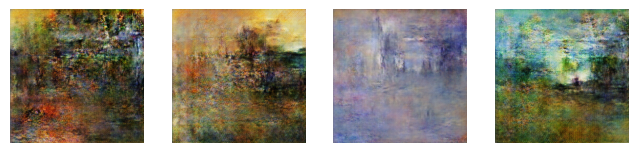

Epoch 1600, generator loss=6.1887, discriminator loss=0.0678, time=3.90 sec


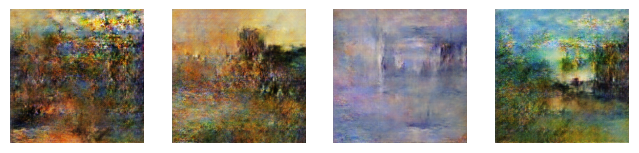

Epoch 1620, generator loss=8.1149, discriminator loss=0.1199, time=3.94 sec


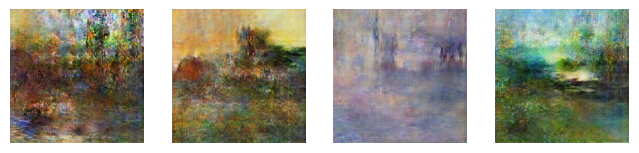

Epoch 1640, generator loss=6.0468, discriminator loss=0.0440, time=3.92 sec


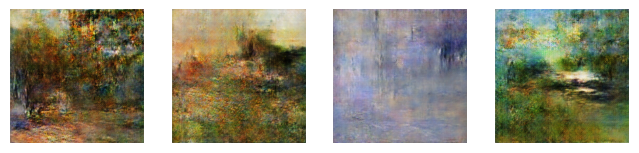

Epoch 1660, generator loss=7.3733, discriminator loss=0.0735, time=3.90 sec


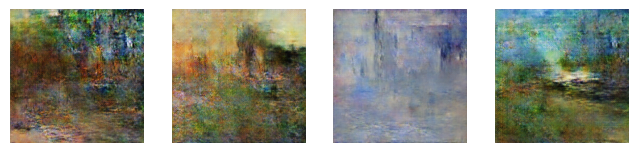

Epoch 1680, generator loss=7.8580, discriminator loss=0.0651, time=3.90 sec


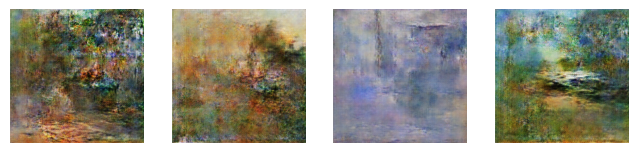

Epoch 1700, generator loss=7.4508, discriminator loss=0.1066, time=3.91 sec


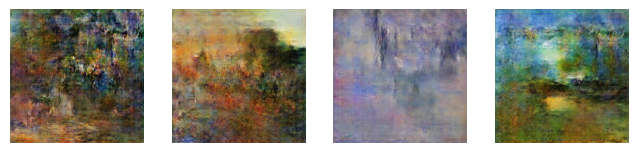

Epoch 1720, generator loss=6.6410, discriminator loss=0.0616, time=3.91 sec


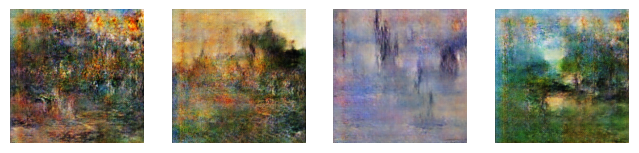

Epoch 1740, generator loss=7.5169, discriminator loss=0.0566, time=3.90 sec


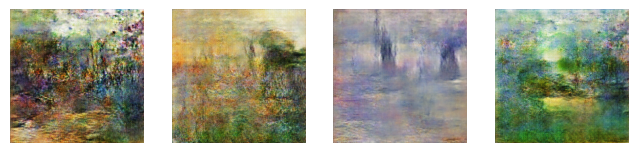

In [11]:
BATCH_SIZE = 64
tfrecord_files = [
    data_dir + '/monet_tfrec/monet00-60.tfrec',
    data_dir + '/monet_tfrec/monet04-60.tfrec',
    data_dir + '/monet_tfrec/monet08-60.tfrec',
    data_dir + '/monet_tfrec/monet12-60.tfrec',
    data_dir + '/monet_tfrec/monet16-60.tfrec'
]

dataset = load_dataset(tfrecord_files, BATCH_SIZE)

generator = make_gen()
discriminator = make_discrim()

generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

num_examples_to_gen = 4
seed = tf.random.normal([num_examples_to_gen, 100])

EPOCH = 1750

#actually start the training now:
train(dataset, EPOCH, generator, discriminator, generator_optimizer, discriminator_optimizer)

now to see if we can make art

In [12]:
def create_art(model, total_pics, directory, batch_size = 10):
    #make sure directory exists
    if not os.path.exists(directory):
        os.makedirs(directory)

    for start_batch in range(0, total_pics, batch_size):
        end_batch = min(start_batch + batch_size, total_pics)
        num_images = end_batch - start_batch
        noise = tf.random.normal([num_images, 100]) #creating different noise patterns for each batch
        predictions = model(noise, training=False)

        for i, img in enumerate(predictions):
            img = (img * 127.5 + 127.5).numpy().astype('uint8')
            image = Image.fromarray(img)
            image.save(f"{directory}/image_{start_batch+i+1:03d}.jpg", 'JPEG')  #saves each image as JPG

#where to save images
output_dir = '../images'

#save resulting images as JPG (will use 7500 at final run)
create_art(generator, 7500, output_dir)

In [13]:
#show that the image files are in the right folder, commented out on final run due to size
#!ls ../images

# Did I make Art? 
take a peek at what was generated

Sample of Generated files


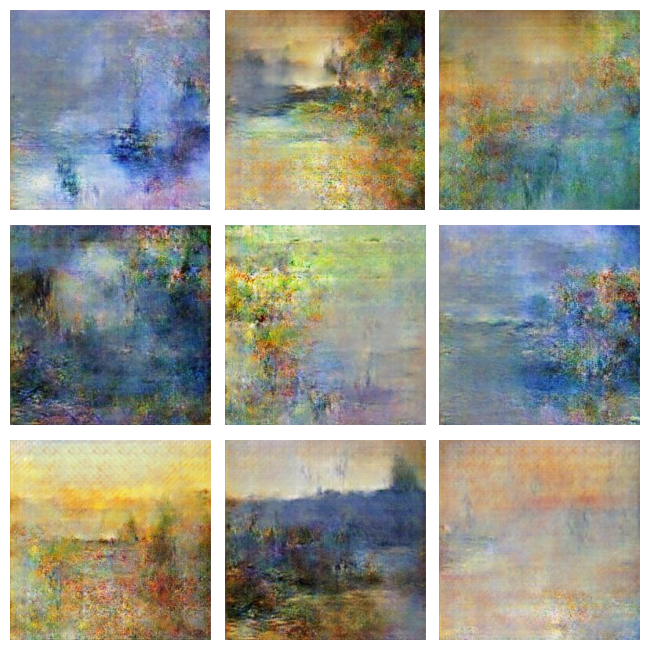

In [14]:
output_files = sorted(glob.glob(os.path.join(output_dir, '*.jpg')))
print("Sample of Generated files")
show_grid(output_files, n=9)

In [15]:
#create zip file
shutil.make_archive("/kaggle/working/images", 'zip', "/kaggle/images")

'/kaggle/working/images.zip'